# EDA to Explore Data Relationships

## Source Data:

https://www.ibm.com/communities/analytics/watson-analytics-blog/hr-employee-attrition/

SAMPLE DATA: HR Employee Attrition and Performance
avatar McKinley Stacker IV  Sep 14, 2015  91925
Watson Analytics Sample Data

Uncover the factors that lead to employee attrition and explore important questions such as ‘show me a breakdown of distance from home by job role and attrition’ or ‘compare average monthly income by education and attrition’. This is a fictional data set created by IBM data scientists.

## The goal of this exercise (10 minutes)

As a new data scientist in a R&D technology company, your executive analytics committee has tasked you to find the driving factors of attrition in the organization. You are planning on doing the following:

**Develop some initial theories on why some empoloyees Attrite and others do not. Write them down and share them once the exercise ends. Use the graphs that have been created for you below. YOU DO NOT HAVE TO DO ANY CODING.**

# Install packages

This may be necesarry to run the first time

In [6]:
!pip install pandas
!pip install ydata_profiling
!pip install seaborn
!pip install matplotlib
!pip install numpy
#!pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 353.0/353.0 kB 5.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 102.7/102.7 kB 11.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 679.5/679.5 kB 11.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 11.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 455.4/455.4 kB 13.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.7/4.7 MB 22.0 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27079 sha256=8171b9e1cfb79ecbc8c8a17fe1ba1949a449416e93e3df6f8c963a2bbf4f02ed
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Successfully built htmlmin
  Attempting uninstall: wordcloud
    Found existing installation: wordcloud 1.8.2.2
    Uninstalling wordcloud-1.8.2.2:
      Successfully uninstalled wordcloud-1.8.2.2
     / 22.6 MB 20.

# Import the data

## Then show the shape and sample the first few rows

In [8]:
import pandas as pd
import seaborn as sns
import pandas as pd
import matplotlib
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
rawData = pd.read_csv("https://raw.githubusercontent.com/jswortz/UIC_Clustering_Code_2019/master/data/WA_Fn-UseC_-HR-Employee-Attrition.csv")


print("Data Shape: {} rows x {} cols".format(len(rawData), len(rawData.columns)))
rawData.head()

Data Shape: 1470 rows x 35 cols


,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,...,1,80,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,...,4,80,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,...,2,80,0,7,3,3,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,...,3,80,0,8,3,3,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,...,4,80,1,6,3,3,2,2,2,2


# Inspect the data, perform Exploratory Data Analysis (EDA)


## Pandas .describe() is used to get basic statistics

In [10]:
rawData.describe()

,Age,DailyRate,DistanceFromHome,Education,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
count,1470.000000,1470.000000,1470.000000,1470.000000,1470.0,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,...,1470.000000,1470.0,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000
mean,36.923810,802.485714,9.192517,2.912925,1.0,1024.865306,2.721769,65.891156,2.729932,2.063946,...,2.712245,80.0,0.793878,11.279592,2.799320,2.761224,7.008163,4.229252,2.187755,4.123129
std,9.135373,403.509100,8.106864,1.024165,0.0,602.024335,1.093082,20.329428,0.711561,1.106940,...,1.081209,0.0,0.852077,7.780782,1.289271,0.706476,6.126525,3.623137,3.222430,3.568136
min,18.000000,102.000000,1.000000,1.000000,1.0,1.000000,1.000000,30.000000,1.000000,1.000000,...,1.000000,80.0,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
25%,30.000000,465.000000,2.000000,2.000000,1.0,491.250000,2.000000,48.000000,2.000000,1.000000,...,2.000000,80.0,0.000000,6.000000,2.000000,2.000000,3.000000,2.000000,0.000000,2.000000
50%,36.000000,802.000000,7.000000,3.000000,1.0,1020.500000,3.000000,66.000000,3.000000,2.000000,...,3.000000,80.0,1.000000,10.000000,3.000000,3.000000,5.000000,3.000000,1.000000,3.000000
75%,43.000000,1157.000000,14.000000,4.000000,1.0,1555.750000,4.000000,83.750000,3.000000,3.000000,...,4.000000,80.0,1.000000,15.000000,3.000000,3.000000,9.000000,7.000000,3.000000,7.000000
max,60.000000,1499.000000,29.000000,5.000000,1.0,2068.000000,4.000000,100.000000,4.000000,5.000000,...,4.000000,80.0,3.000000,40.000000,6.000000,4.000000,40.000000,18.000000,15.000000,17.000000


# Pandas profiling provides a much more robust analysis with formatted HTML output

In [9]:
from ydata_profiling import ProfileReport

ProfileReport(rawData)


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# Distribution Analysis

<ipython-input-11-e5b930ea7dcf>:8: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  ax = sns.kdeplot(x, shade=True, color="r").set_title(col)
<ipython-input-11-e5b930ea7dcf>:9: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  ax = sns.distplot(x)
<ipython-input-11-e5b930ea7dcf>:8: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  ax = sns.kdeplot(x, shade=True, color="r").set_title(col)
<ipython-input-11-e5b930ea7dcf>:9: UserWarning: 

`distpl

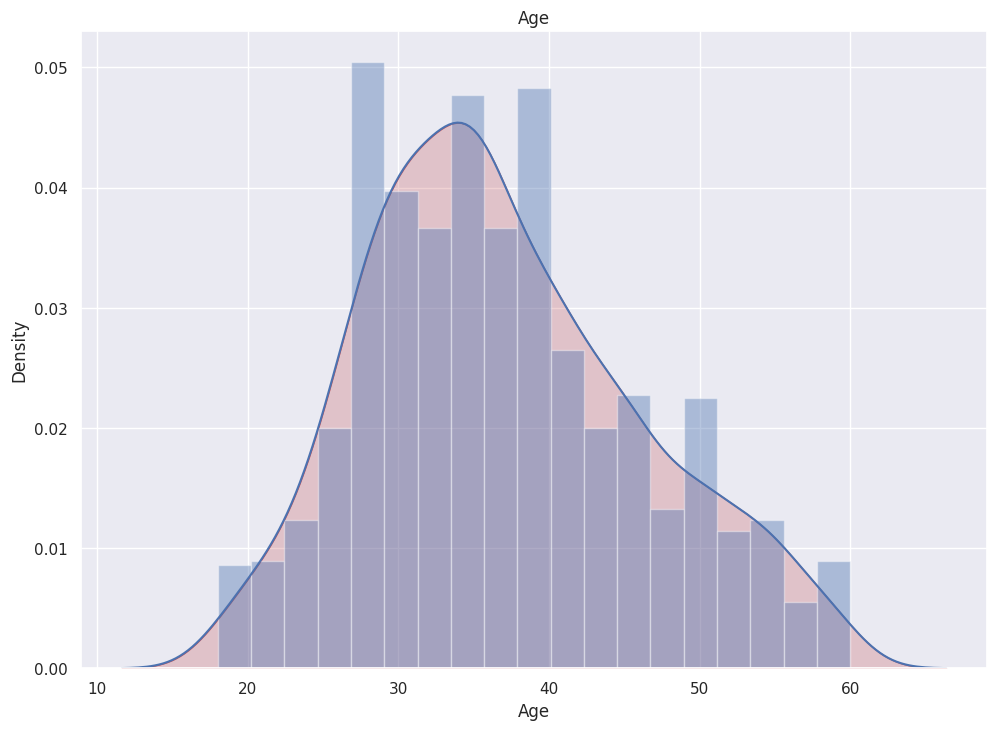

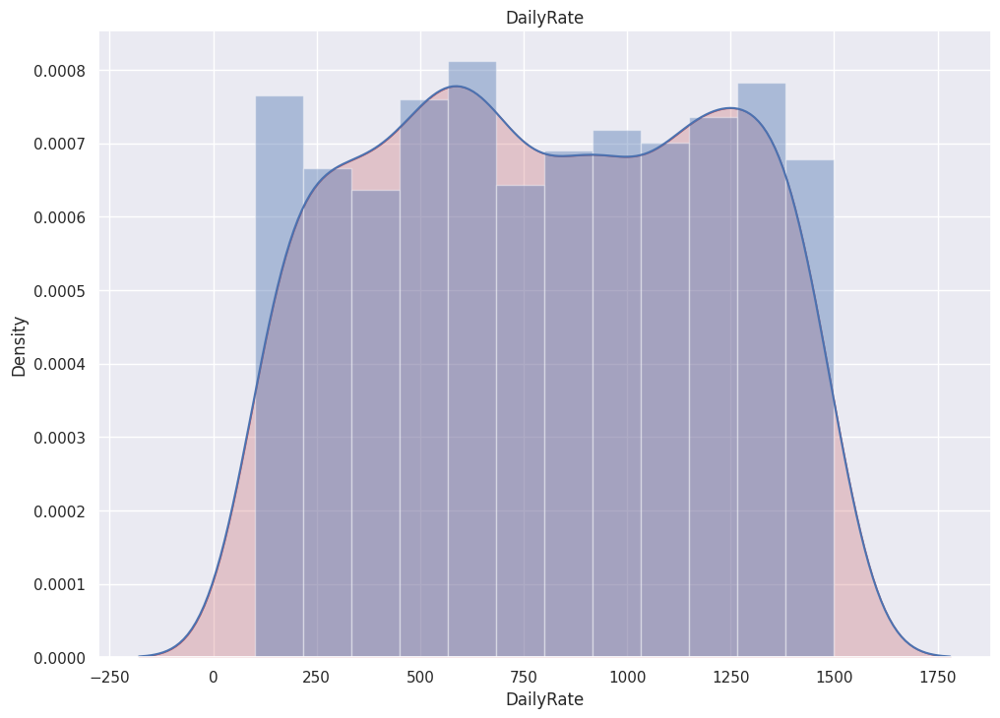

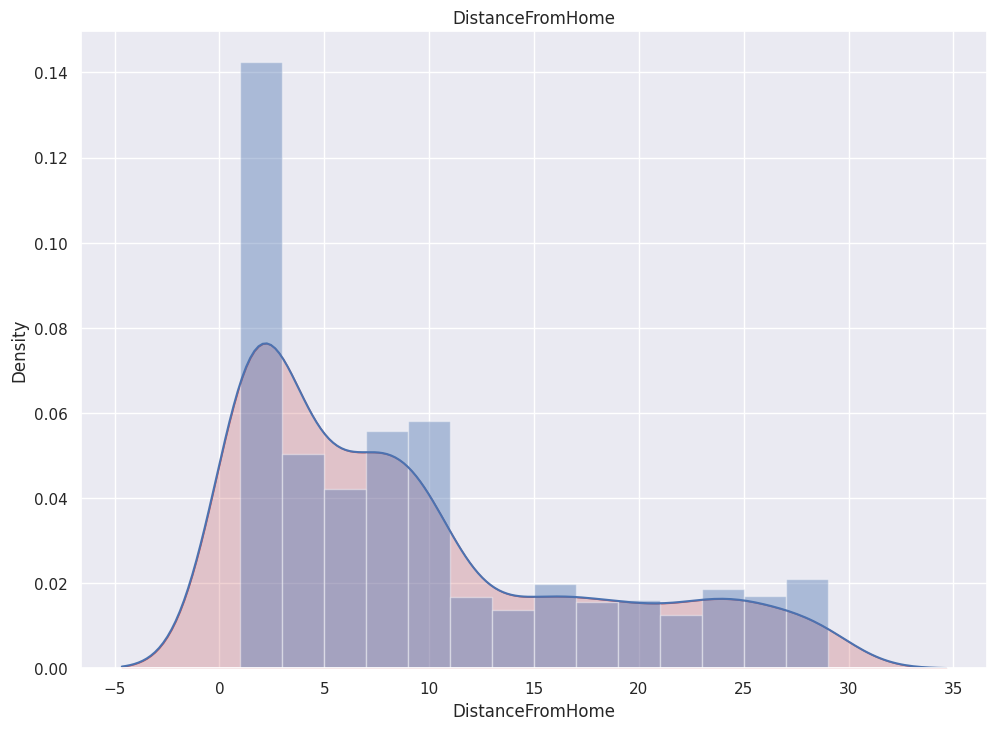

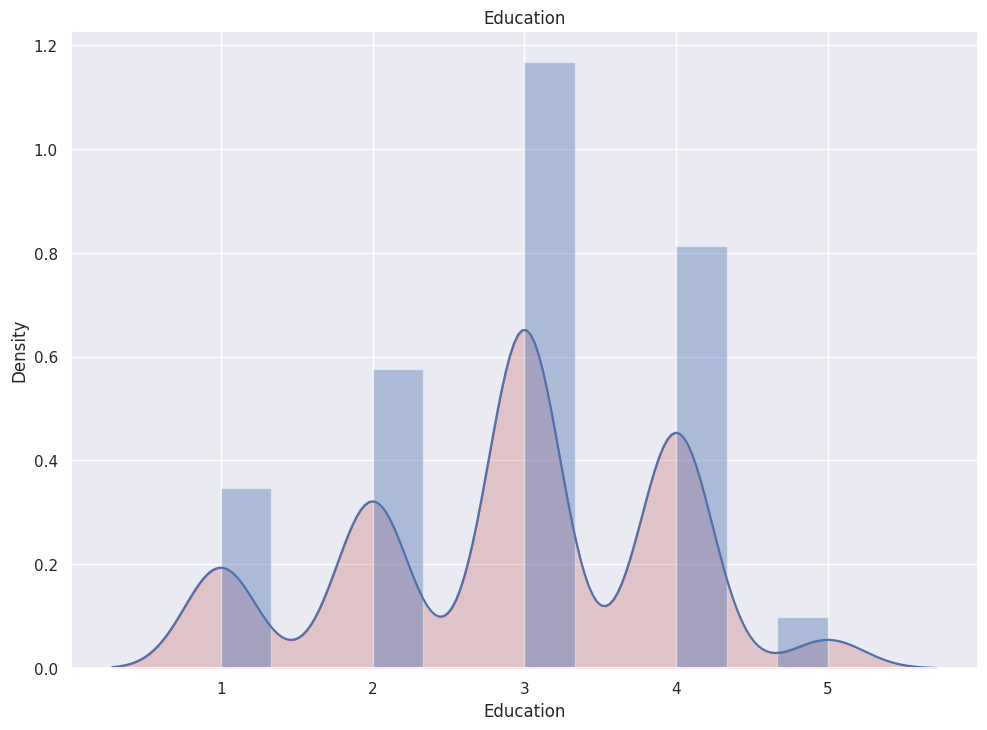

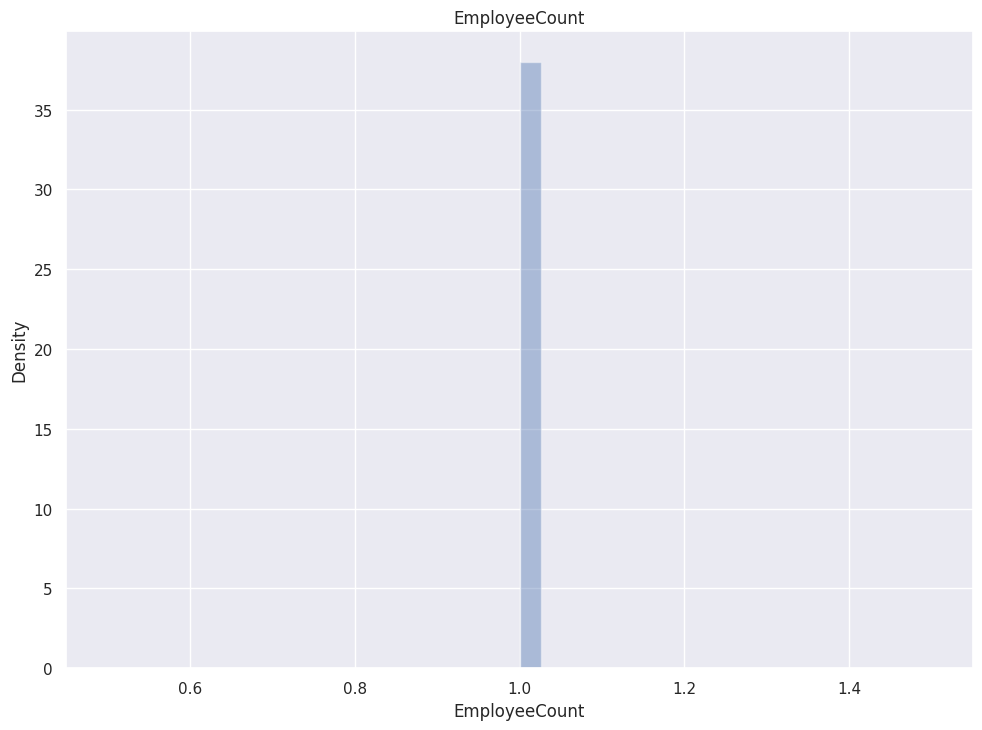

...

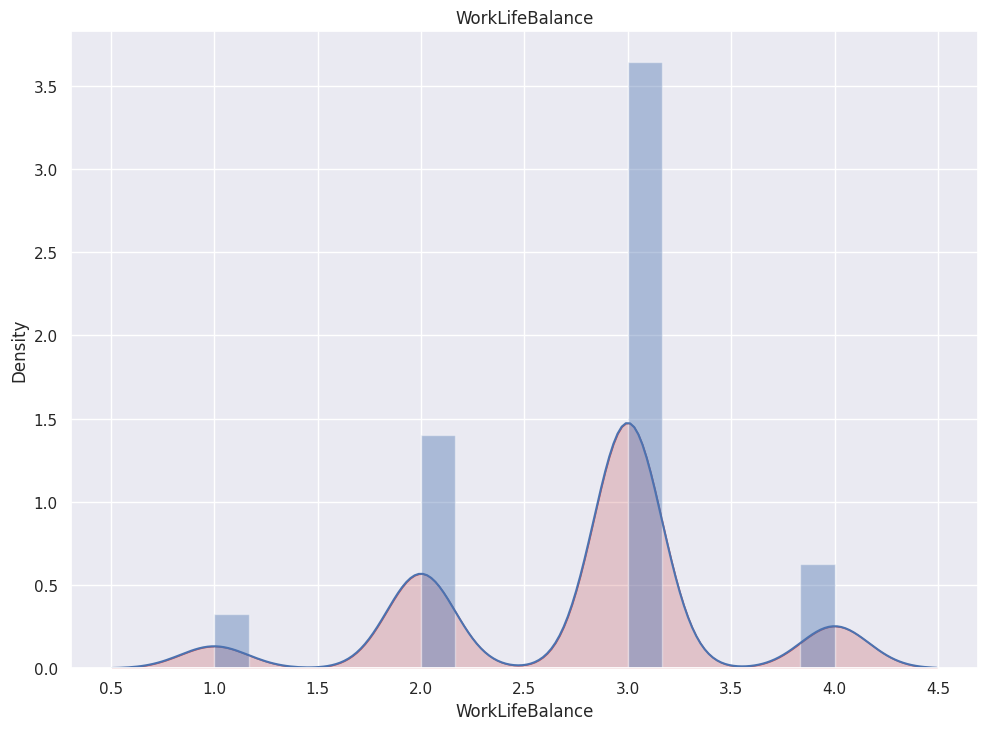

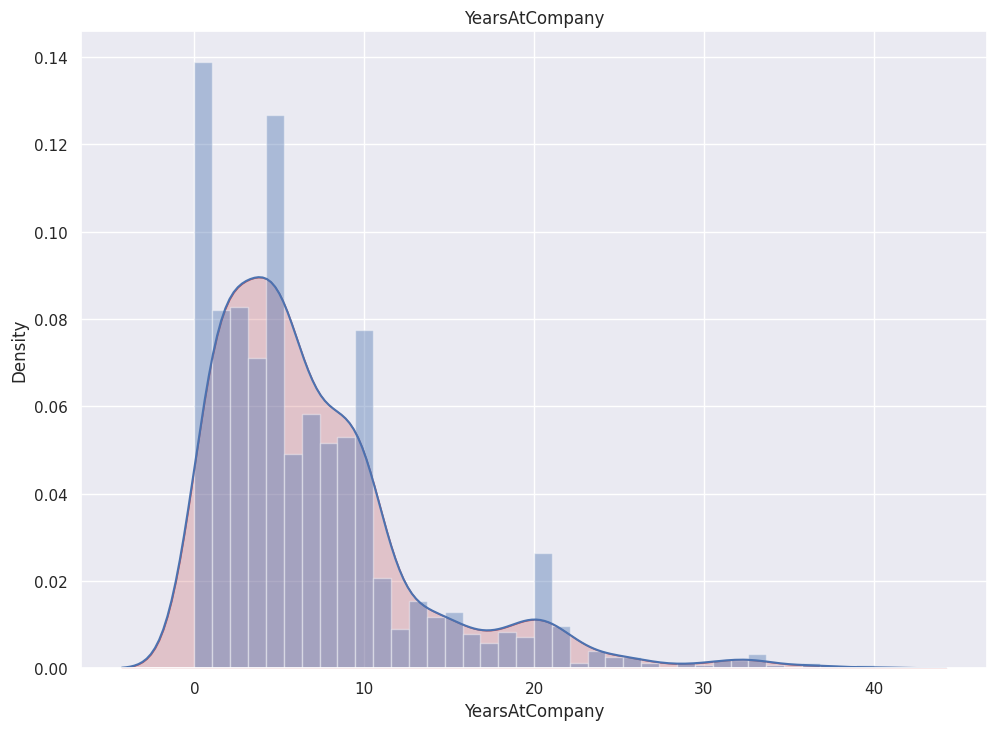

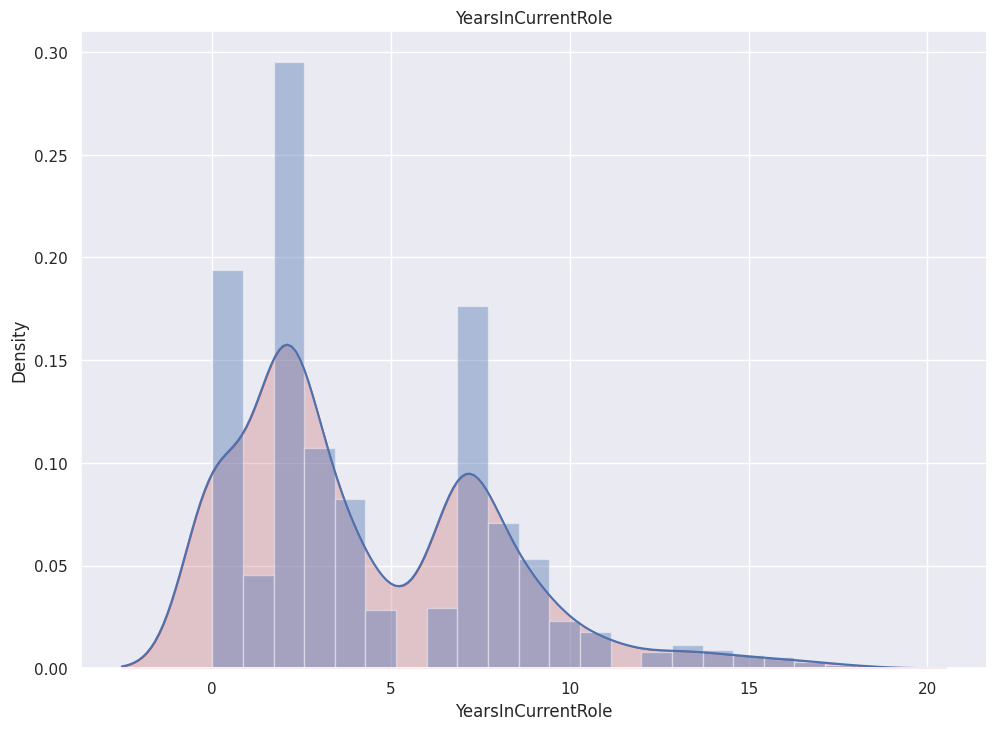

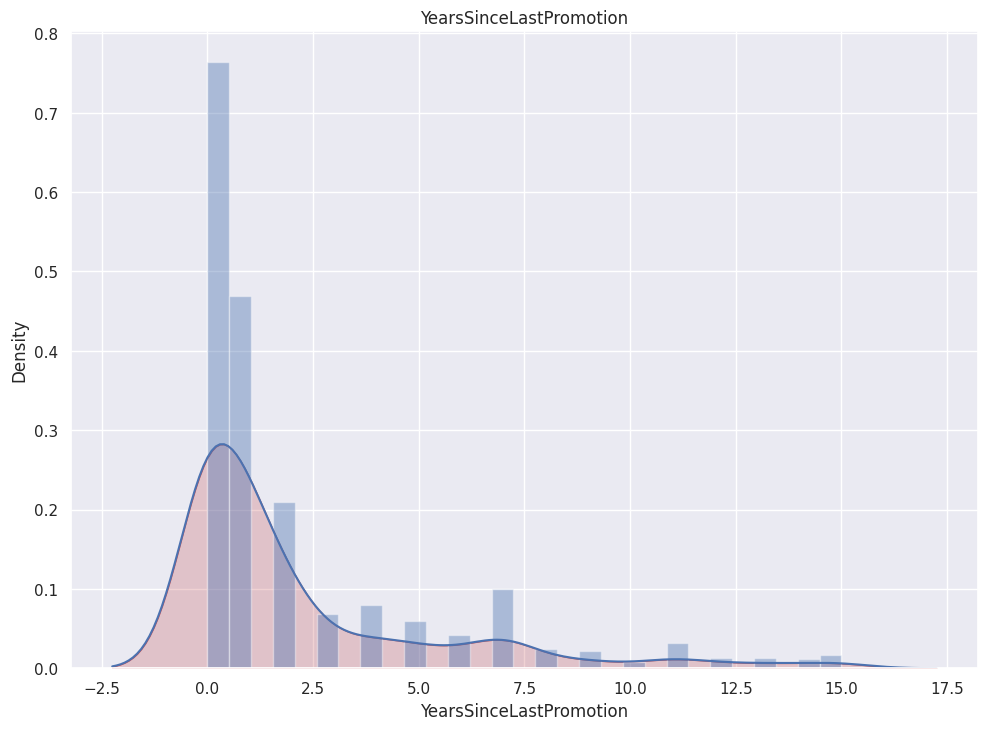

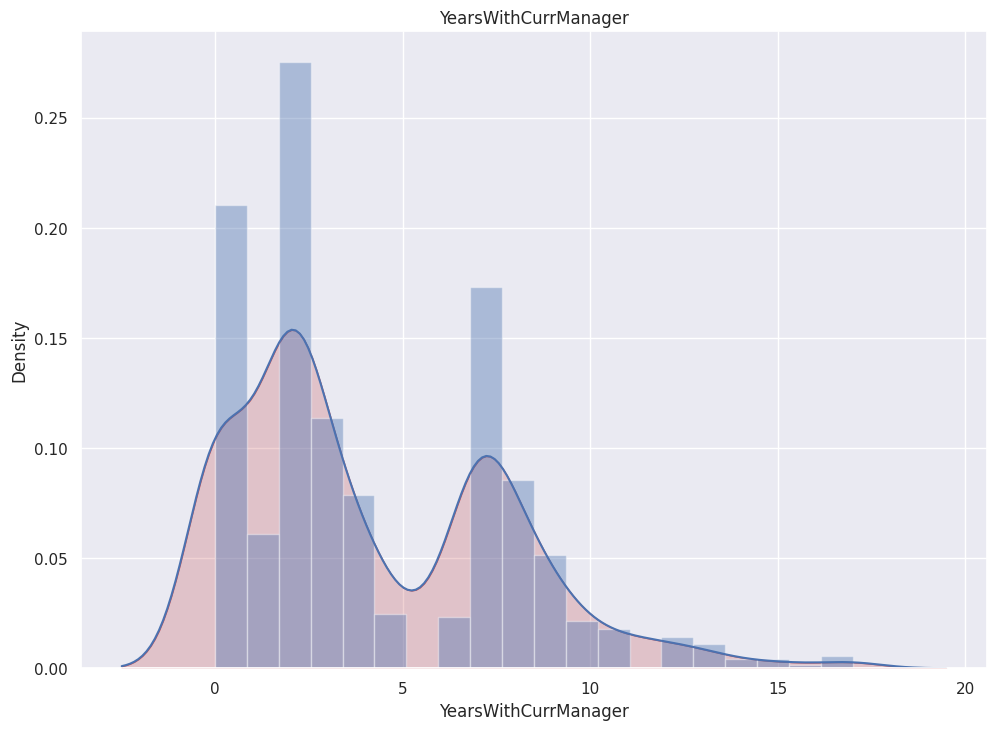

In [11]:
num_cols = rawData._get_numeric_data().columns
sns.set(rc={'figure.figsize':(11.7,8.27)})
%matplotlib inline
for col in num_cols:
    x = rawData[col]
    plt.figure(col)
    try:
        ax = sns.kdeplot(x, shade=True, color="r").set_title(col)
        ax = sns.distplot(x)
    except Exception as e:
        print("didn't work for varaible: {}, {}".format(col, e))

# Distribution Bivariate Plots

<ipython-input-13-91e54d8ed2b9>:13: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  ax = sns.kdeplot(x0, shade=True, color="b", legend=True).set_title(col)
<ipython-input-13-91e54d8ed2b9>:15: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  ax = sns.kdeplot(x1, shade=True, color="r", legend=True)
<ipython-input-13-91e54d8ed2b9>:13: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  ax = sns.kdeplot(x0, shade=True, color="b", legend=True).set_title(col)
<ipython-input-13-91e54d8ed2b9>:15: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  ax = sns.kdeplot(x1, sh

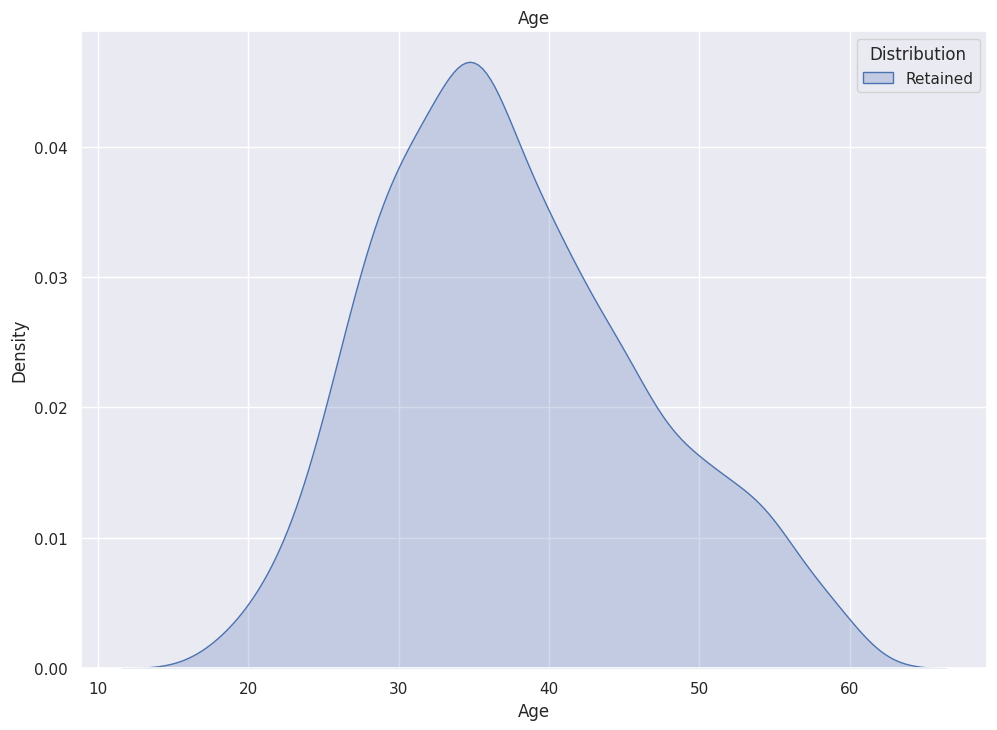

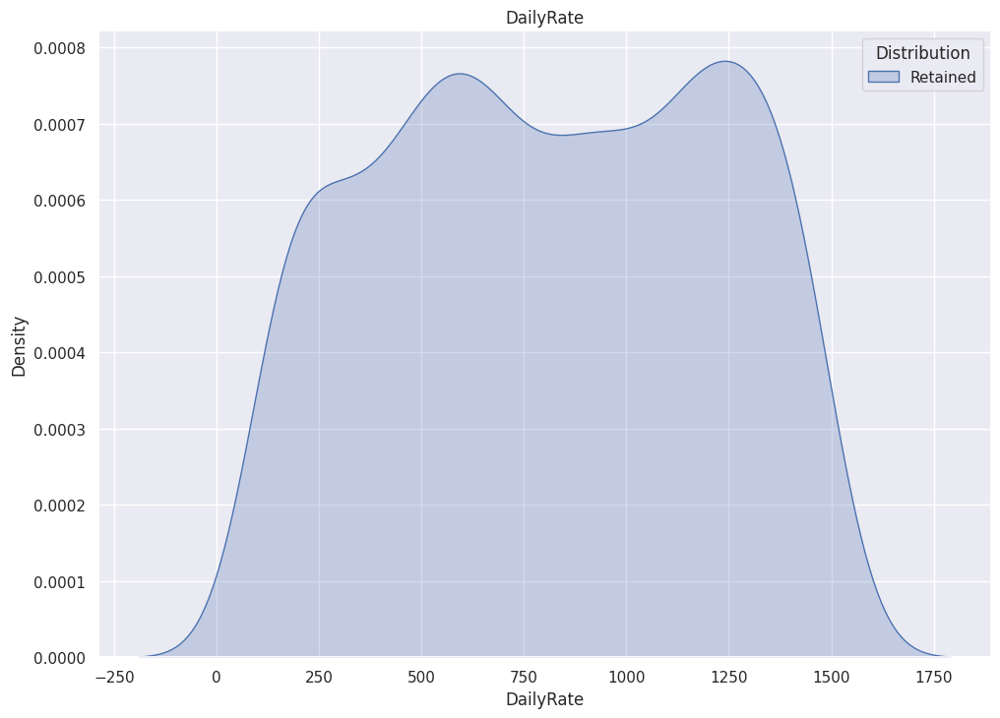

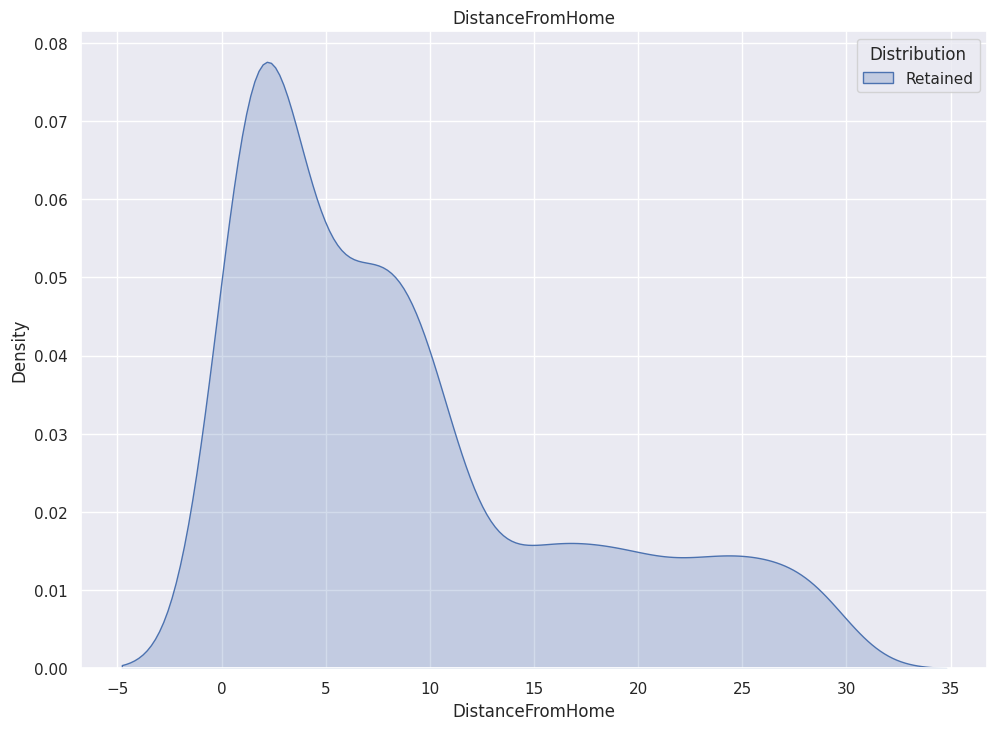

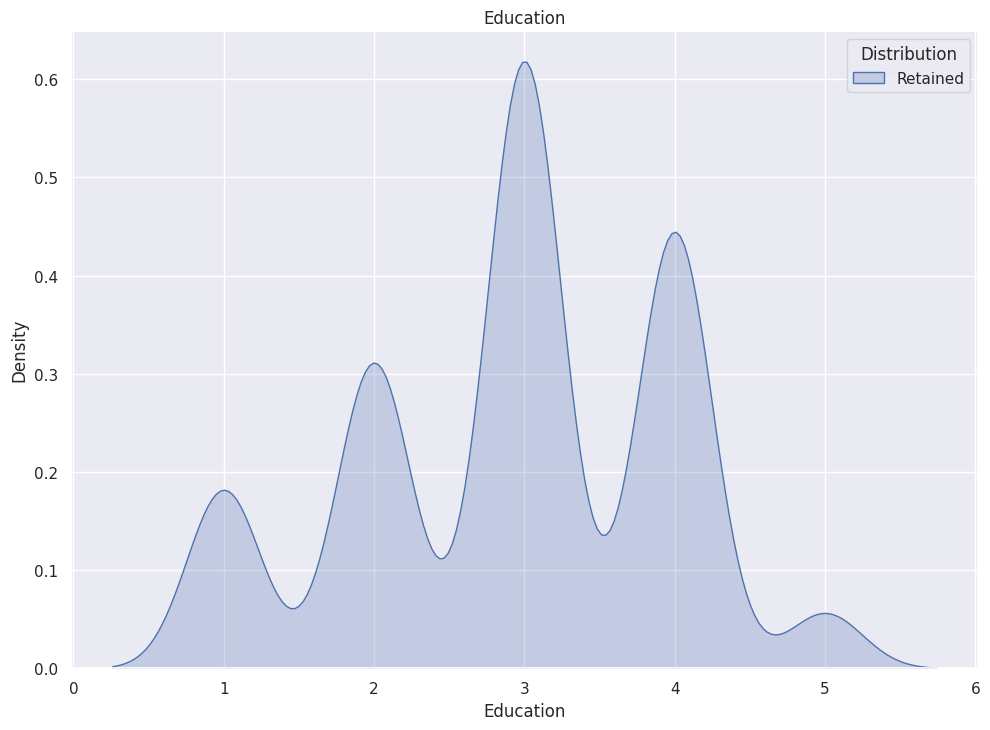

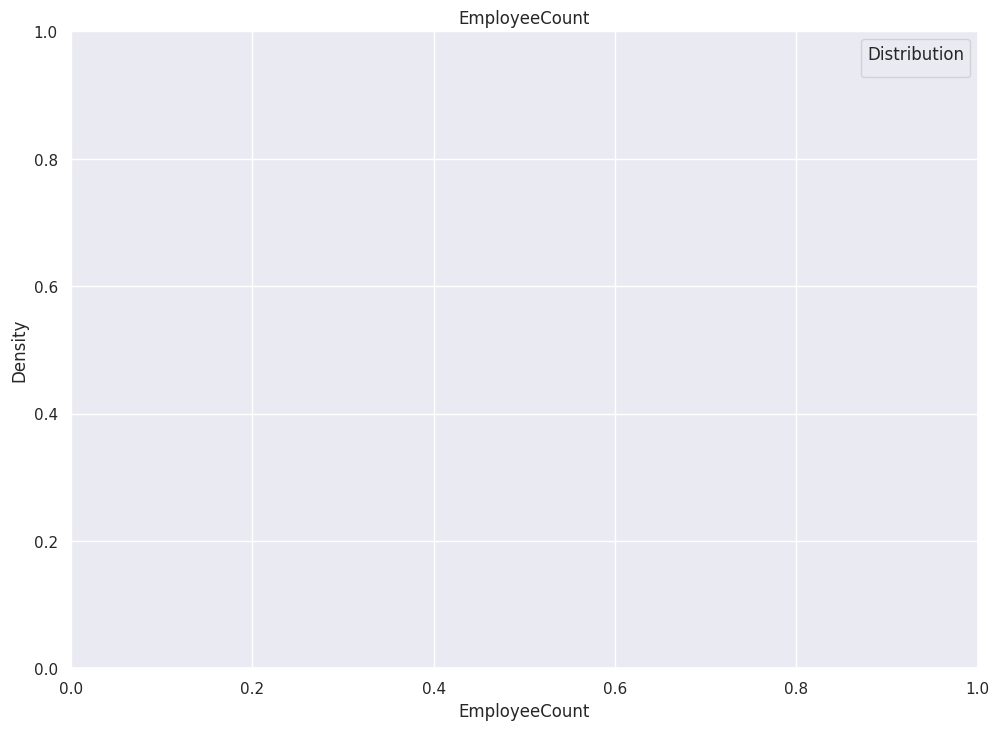

...

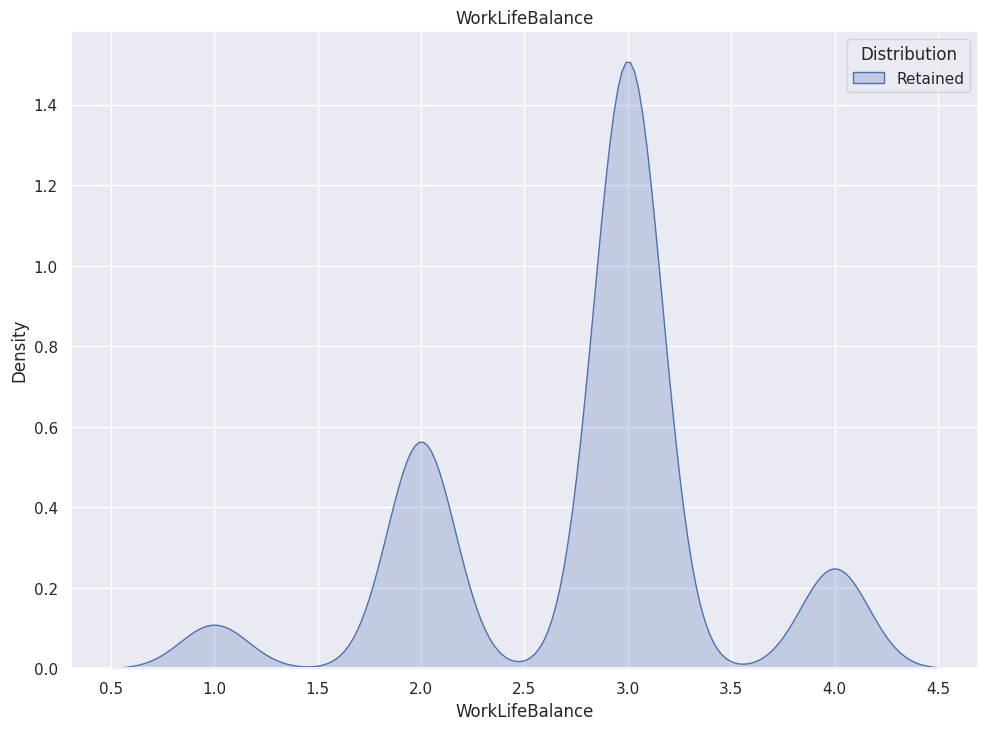

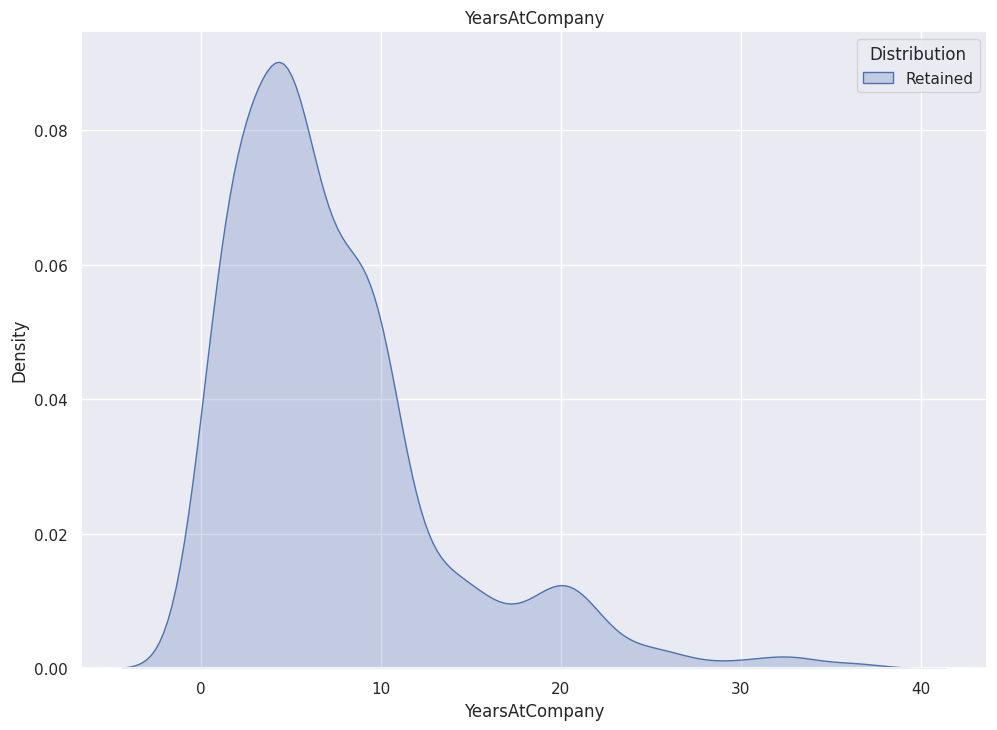

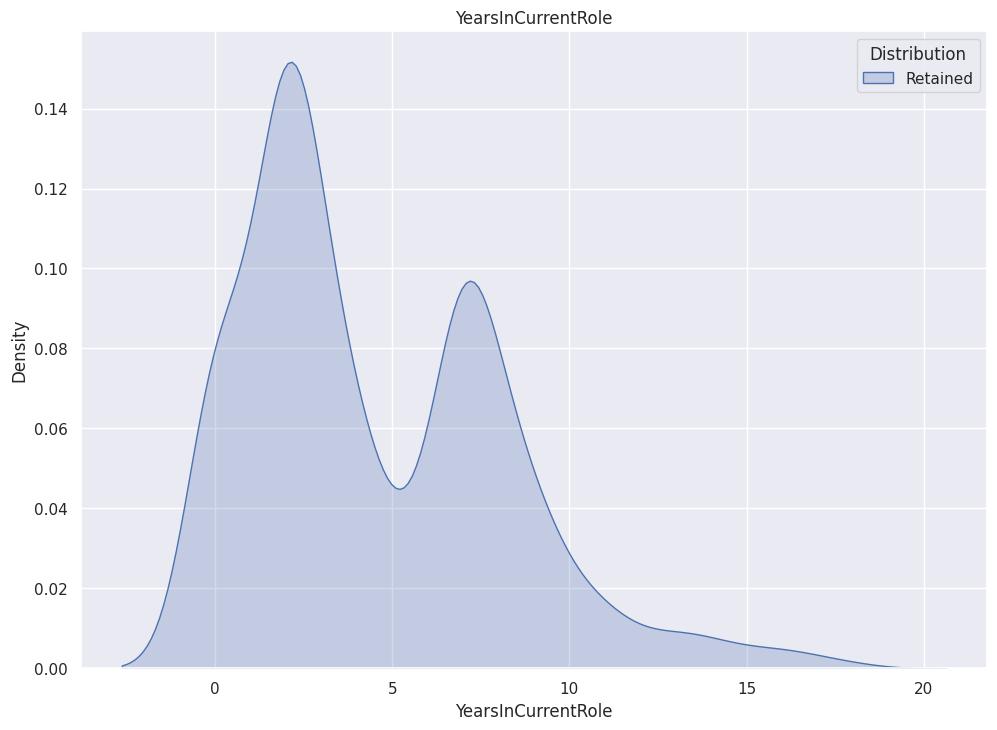

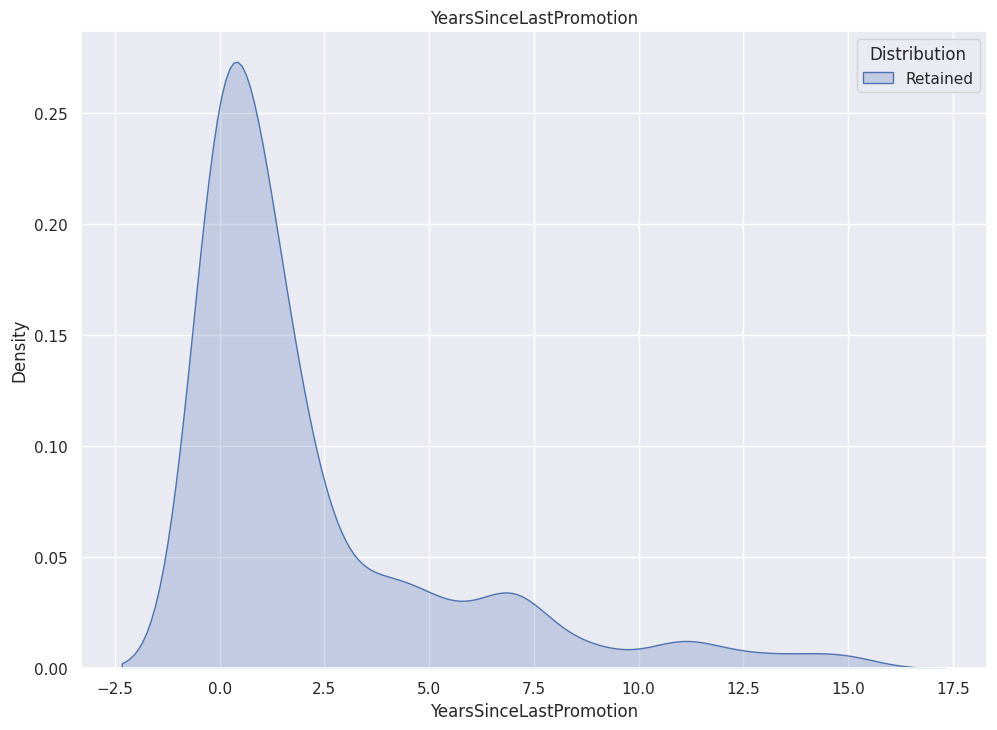

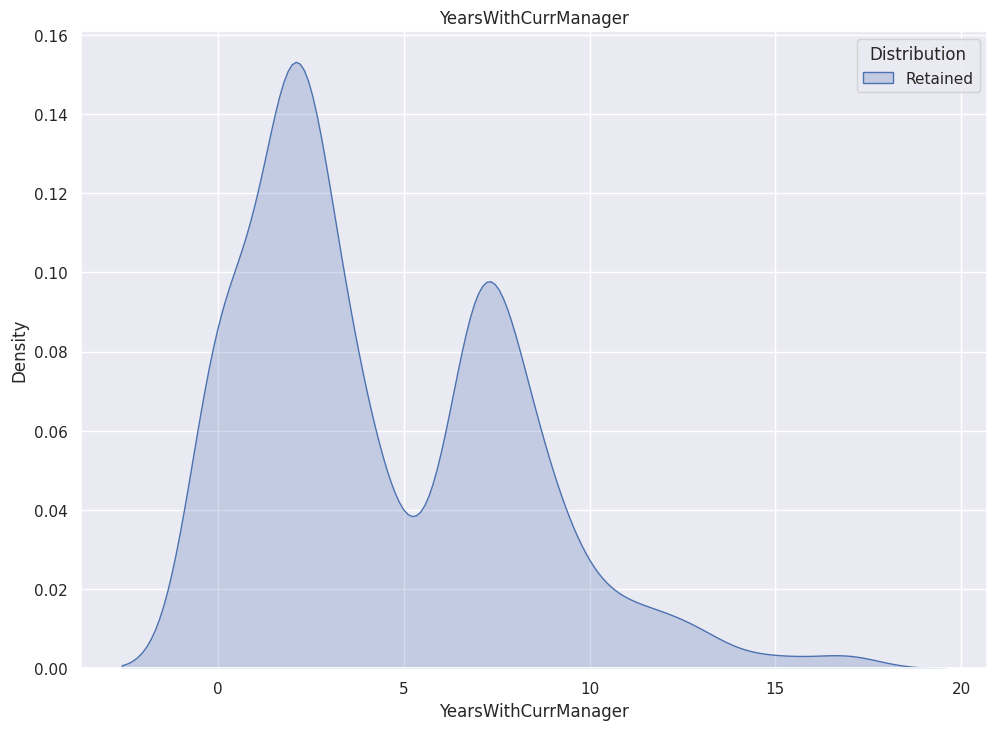

In [13]:
sns.set(rc={'figure.figsize':(11.7,8.27)})
#NOTE THIS WORKS if TARGET IS 0 OR 1
d0 = rawData[rawData["Attrition"] == "No"]
d1 = rawData[rawData["Attrition"] == "YES"]

for col in num_cols:
    x0 = d0[col]
    x1 = d1[col]
    plt.figure()

    try:
        new_labels = ['Retained', 'Attrited']
        ax = sns.kdeplot(x0, shade=True, color="b", legend=True).set_title(col)

        ax = sns.kdeplot(x1, shade=True, color="r", legend=True)
        plt.legend(title='Distribution', loc='upper right', labels=new_labels)
    except Exception as e:
        print(e)
        print(col)
        pass